# prompting the past
Distant reading code for the [Prompting the Past DH 2024 proposal](https://github.com/inactinique/DH2024_prompting_the_past/).
This code has been written with the help of ChatGPT and ollama (codellama)

This is a work in progress.

## We start with LDA (gensim)

### required libraries

- gensim (gensim-4.3.2 numpy-1.26.2 scipy-1.11.4 smart-open-6.4.0)
- pandas (pandas-2.1.3 pytz-2023.3.post1 tzdata-2023.3)
- nltk (click-8.1.7 nltk-3.8.1 regex-2023.10.3 tqdm-4.66.1)
- pyLDAvis (MarkupSafe-2.1.3 funcy-2.0 jinja2-3.1.2 joblib-1.3.2 numexpr-2.8.7 pyLDAvis-3.4.1 scikit-learn-1.3.2 setuptools-69.0.2 threadpoolctl-3.2.0)
- matplotlib (contourpy-1.2.0 cycler-0.12.1 fonttools-4.46.0 kiwisolver-1.4.5 matplotlib-3.8.2 pyparsing-3.1.1)
- networkx-3.2.1
- plotly (plotly-5.18.0 tenacity-8.2.3)
-  fastjsonschema-2.19.0 jsonschema-4.20.0 jsonschema-specifications-2023.11.2 nbformat-5.9.2 referencing-0.31.1 rpds-py-0.13.2

In [1]:
# Install necessary libraries if you haven't already
# !pip install gensim
# !pip install numpy
# !pip install nltk 
# !pip install pyLDAvis
# !pip install matplotlib
# !pip install networkx
# !pip install plotly
# !pip install nbformat
# !pip install re
# !pip install pandas


# beware: scikit version must be max 1.12.0

### import libraries

In [2]:
# Import libraries
from gensim import corpora
from gensim.models import LdaModel
from gensim.corpora import Dictionary
from pprint import pprint
import nltk
from nltk.corpus import stopwords
import csv


### load the corpus

In [3]:
# define corpus_file

# remove # below to work with the european union file
# corpus_file = 'data/european_union.txt'
# Read the corpus from the file
# with open(corpus_file, 'r', encoding='utf-8') as file:
#    corpus = [line.strip() for line in file]

# fun with the krea corpus
# the krea has 10 778 778 rows
corpus_file = 'data/prompts.csv'
corpus_prefilter = []

# Read the csv file
with open(corpus_file, 'r', encoding='utf-8') as file:
    reader = csv.reader(file)
    header = next(reader) # This will store the first row (header) in a variable
    for row in reader:
        corpus_prefilter.append(row[0]) # only append the first column of each row

### filter the corpus

In [4]:
# Filter the corpus. Uncomment if interesting. We filter here on those words: 'european', 'europe', 'EU'
# query_list = ['european union', 'european parliament', 'european commission', 'european council']
# corpus = [row for row in corpus_prefilter if any(query in row for query in query_list)]
# print(corpus)

# We're goin to filter it to get all rows with a word starting with 'histor'

import re

corpus = [text for text in corpus_prefilter if re.search(r'\bhistor', text.lower()) or 'past' in text.lower()]

In [33]:
print("Number of rows in the corpus", len(corpus))

print("First 5 elements:", corpus[:5])
print("Last 5 elements:", corpus[-5:])

Number of rows in the corpus 140453
First 5 elements: ['epic portrait mona lisa eating an apple, beauty, pretty face, glossy skin, shiny, wet hair, digital painting, artstation, concept art, soft light, hdri, smooth, sharp focus, illustration, fantasy, intricate, elegant, highly detailed, D&D, matte painting, in the style of Greg Rutkowski and Alphonse Mucha and artemisia, 8k, highly detailed, jurgens, rutkowski, bouguereau, pastoral, rustic, georgic', 'high quality high detail painting by norman rockwell, hd, close up portrait, pretty young woman, muted pastel colors, photorealistic lighting', 'Concept art Portrait of the ancient historical biblical SNARLING ANGRYING YELLING, jealous king Saul of Israel by craig mullins and marc simonetti, ARTSTATION, cgsociety, polycount, character design, CINEMATIC, AWE INSPIRING, BEAUTIFUL, ART GERM', 'telephoto 7 0 mm f / 2. 8 iso 2 0 0 photograph depicting the feeling of chrysalism in a cosy safe cluttered french sci - fi ( art nouveau ) cyberpun

### write the filtered corpus, for instance for use in iramuteq

In [6]:
with open("filtered_corpus_histor.txt", "w", encoding='utf-8') as file:
    file.writelines(f"{item}\n" for item in corpus)

### prepare the corpus: remove stopwords, tokenize, create a dictionnary, filter out few used words

In [32]:
# we disable ssl checking, otherwise nltk.download won't work. Other solutions are available here: https://stackoverflow.com/questions/41348621/ssl-error-downloading-nltk-data
# uncomment if necessary (if nltk_data is not downloaded)

# import ssl
#try:
#    _create_unverified_https_context = ssl._create_unverified_context
#except AttributeError:
#    pass
#else:
#    ssl._create_default_https_context = _create_unverified_https_context

# nltk stopwords

# Import NLTK stopwords
stop_words = set(stopwords.words('english'))

# Tokenize and clean the texts
def preprocess_text(text):
    # Convert to lowercase and remove non-alphanumeric characters
    text = re.sub(r'[^a-zA-Z0-9]', ' ', text.lower())
    # Tokenize and remove stopwords
    tokens = [word for word in text.split() if word not in stop_words and len(word) > 2]
    return tokens

# Tokenize and clean the entire corpus
tokenized_texts = [preprocess_text(text) for text in corpus]

# Create a dictionary representation of the documents
dictionary = Dictionary(tokenized_texts)

# Filter out words that occur less than 5 documents or more than 50% of the documents
dictionary.filter_extremes(no_below=5, no_above=0.5)

### And now LDA


In [34]:
# Create a bag-of-words representation of the documents
corpus_bow = [dictionary.doc2bow(text) for text in tokenized_texts]

# Train the LDA model
num_topics = 150  # You can adjust this parameter based on your requirements
lda_model = LdaModel(corpus_bow, num_topics=num_topics, id2word=dictionary, passes=15)

# Print the topics and their top words
pprint(lda_model.print_topics())

### Visualize topics

In [14]:
# Import library
import pyLDAvis.gensim_models as gensimvis
import pyLDAvis

# Visualize topics
pyLDAvis.enable_notebook()
vis = gensimvis.prepare(lda_model, corpus_bow, dictionary)
pyLDAvis.display(vis)


### looking at dominant topic for each document (line in the corpus)

In [15]:
# Get the dominant topic for each document in the corpus
dominant_topics = [max(lda_model[doc], key=lambda x: x[1]) for doc in corpus_bow]

# Create a dictionary to store texts for each topic
topics_dict = {i: [] for i in range(num_topics)}

# Group texts by their dominant topics
for i, topic in enumerate(dominant_topics):
    topics_dict[topic[0]].append(corpus[i])

# Print texts for each topic
for topic, texts in topics_dict.items():
    print(f"Topic {topic}:")
    for text in texts:
        print(f" - {text}")
    print("\n")

Topic 0:
 - i really cool background for the game of age of history 2 the background need to be about ww 2 photo - realistic interact with the lighting
 - futuristic, pastel colors, hd 8 k, digital design, abandoned, overgrown, candy shop in a mall
 - cyberpunk concept cool warrior girl bot, cinema 4 d, galaxy, ufo, space sci - fi, wearing vr goggles, illustration, portrait, pastel neon textured background night, trending on artstation, greg rutkowski, octane rendered, 1 2 k, detailed,
 - futuristic space station in the snowy mountains 3 d concept art, cinematic lighting, intricate details, building by zaha hadid, pastel sunset, emissary space by arthur haas and bruce pennington and john schoenherr, cinematic matte painting, dark moody monochrome colors, trending on artstation, featured on behance
 - cyberpunk concept cool warrior girl bot, galaxy, ufo, space sci - fi, wearing vr goggles, illustration, portrait, pastel neon textured background night, trending on artstation, greg rutkow

# number of documents per topics

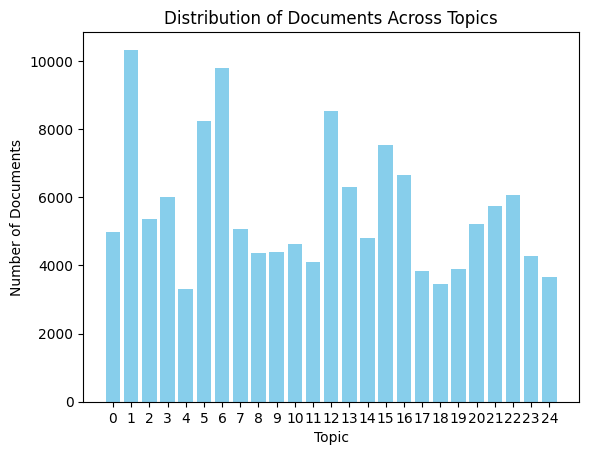

In [16]:

import matplotlib.pyplot as plt
import numpy as np

# Count the number of documents in each topic
topic_counts = np.zeros(num_topics)
for topic in dominant_topics:
    topic_counts[topic[0]] += 1

# Plot the bar chart
plt.bar(range(num_topics), topic_counts, tick_label=range(num_topics), color='skyblue')
plt.xlabel('Topic')
plt.ylabel('Number of Documents')
plt.title('Distribution of Documents Across Topics')
plt.show()


## word2vec

In [ ]:
# If you already have a pre-trained model, then you don't need to recreate it.
# Import libraries
from gensim.models import Word2Vec
import re

# Read the corpus from the file
with open(corpus_file, 'r', encoding='utf-8') as file:
    corpus = [line.strip() for line in file]

# Import NLTK stopwords
stop_words = set(stopwords.words('english'))

# Tokenize and clean the texts
def preprocess_text(text):
    # Convert to lowercase and remove non-alphanumeric characters
    text = re.sub(r'[^a-zA-Z0-9]', ' ', text.lower())
    # Tokenize and remove stopwords
    tokens = [word for word in text.split() if word not in stop_words]
    return tokens

# Tokenize and clean the entire corpus
tokenized_corpus = [preprocess_text(text) for text in corpus]

# Train the Word2Vec model
model_w2v = Word2Vec(sentences=tokenized_corpus, vector_size=100, window=5, min_count=5, workers=4)

# Save the model for future use
model_w2v.save('word2vec_model.model')

# Example usage: find similar words to a given word
similar_words = model_w2v.wv.most_similar('napoleon', topn=5)
print("Similar words to 'napoleon':", similar_words)


In [2]:
# if you already have a pretrained model, then load it first
from gensim.models import Word2Vec

# Load pre-trained Word2Vec model.
model_w2v = Word2Vec.load("word2vec_model.model")

# Example usage: find similar words to a given word
similar_words = model_w2v.wv.most_similar('history', topn=500)
print("Similar words to 'history':", similar_words)

Similar words to 'history': [('solidarity', 0.5167937874794006), ('3160662516', 0.5093499422073364), ('1115384538', 0.509257972240448), ('gallery', 0.5030828714370728), ('nanyang', 0.4973986744880676), ('engaged', 0.49212002754211426), ('consider', 0.49070557951927185), ('especially', 0.4903973639011383), ('canvases', 0.4858241379261017), ('satirical', 0.48069560527801514), ('landsurveying', 0.4744797945022583), ('populous', 0.4652368426322937), ('artsystem', 0.4644748866558075), ('admir', 0.46219637989997864), ('3439676031', 0.4608253538608551), ('1697444330', 0.4578271508216858), ('tarkins', 0.45758479833602905), ('depict', 0.4558314085006714), ('chores', 0.452091783285141), ('flown', 0.451050341129303), ('success', 0.45037487149238586), ('existed', 0.4485679268836975), ('auwfull', 0.446606308221817), ('usa', 0.44605210423469543), ('2867681198', 0.44595009088516235), ('exhobit', 0.4456143081188202), ('3007975452', 0.44292160868644714), ('1703070927', 0.4420071840286255), ('work', 0.4

### Let's visualize some word vectors

In [ ]:
# Import libraries
import matplotlib.pyplot as plt
import networkx as nx

# Get the 3000 most used words in the corpus
most_used_words = model_w2v.wv.index_to_key[:3000]

# Create a graph
G = nx.Graph()

# Add nodes for the most used words
G.add_nodes_from(most_used_words)

# Add edges between each word and its similar words
for word in most_used_words:
    similar_words = model_w2v.wv.most_similar(word, topn=5)
    for similar_word, _ in similar_words:
        G.add_edge(word, similar_word)

# Plot the graph
pos = nx.spring_layout(G, seed=42)  # Set seed for reproducibility
plt.figure(figsize=(12, 12))
nx.draw(G, pos, with_labels=True, font_size=8, node_size=2000, font_color='black', node_color='skyblue', edge_color='gray', linewidths=0.5)
plt.title('Graph of Similar Words to the 3000 Most Used Words')
plt.show()


In [ ]:
# export the graph in GraphML format
nx.write_graphml(G, "word_similarity_graph.graphml")

/var/folders/90/j99p488148vcmjxgs16_mq0j42556r/T/ipykernel_6555/3525749616.py:55: UserWarning: This figure includes Axes that are not compatible with tight_layout, so results might be incorrect.
  plt.tight_layout()


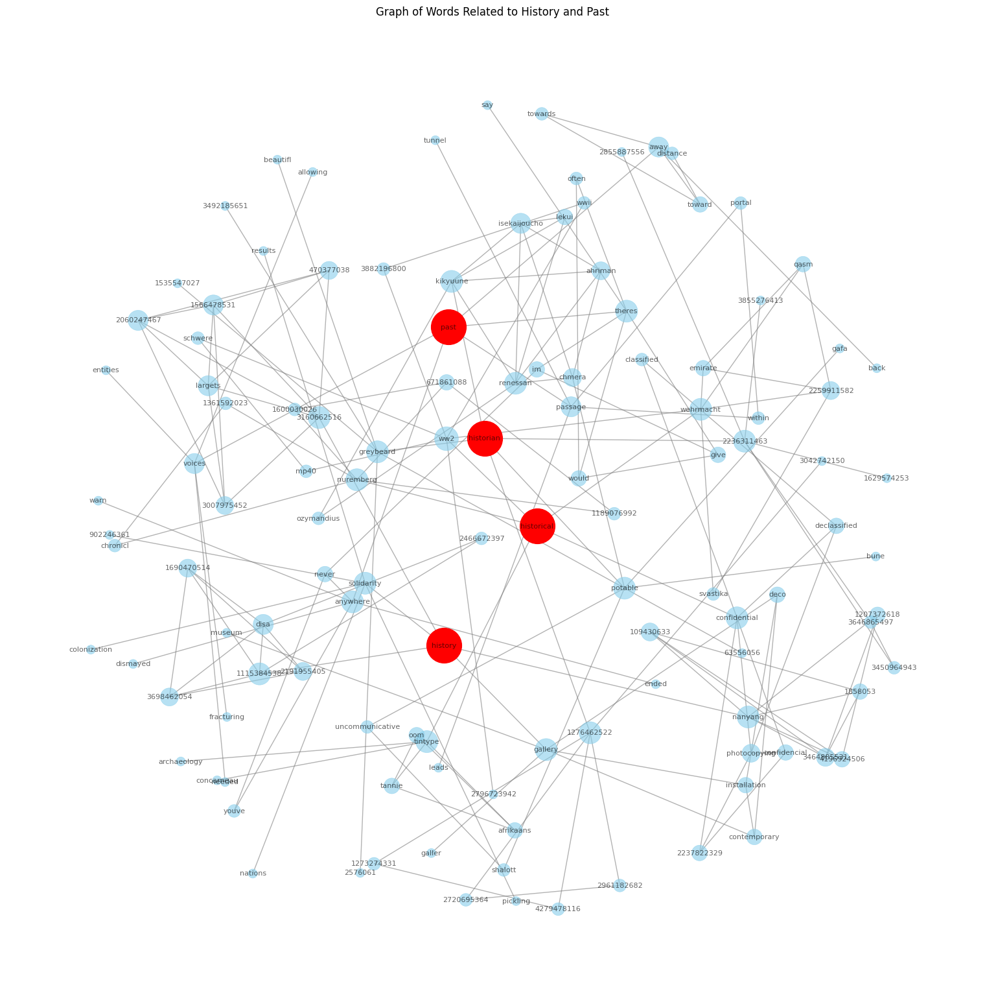

In [31]:
import matplotlib.pyplot as plt
import networkx as nx

# Define the seed words
seed_words = ['history', 'historical', 'historian', 'past']

# Create a graph
G = nx.Graph()

# Function to get related words
def get_related_words(word, model, depth=2):
    related = set([word])
    for _ in range(depth):
        new_words = set()
        for w in related:
            if w in model.wv:
                similar_words = model_w2v.wv.most_similar(w, topn=5)
                new_words.update([sw for sw, _ in similar_words])
        related.update(new_words)
    return related

# Get related words and add nodes and edges
all_related_words = set()
for seed in seed_words:
    related = get_related_words(seed, model_w2v)
    all_related_words.update(related)

G.add_nodes_from(all_related_words)

for word in all_related_words:
    if word in model_w2v.wv:
        similar_words = model_w2v.wv.most_similar(word, topn=5)
        for similar_word, similarity in similar_words:
            if similar_word in all_related_words:
                G.add_edge(word, similar_word, weight=similarity)

# Plot the graph
pos = nx.spring_layout(G, k=0.5, iterations=50)  # Adjust k for more spread out graph
plt.figure(figsize=(15, 15))

# Calculate node sizes based on degree
degrees = dict(G.degree())
node_sizes = [v * 100 for v in degrees.values()]  # Multiply by 100 to make sizes more visible

nx.draw(G, pos, with_labels=True, font_size=8,
        node_size=node_sizes,  # Use the calculated node sizes
        font_color='black', node_color='skyblue', edge_color='gray',
        linewidths=0.5, alpha=0.6)

# Add seed words with different color
nx.draw_networkx_nodes(G, pos, nodelist=seed_words, node_color='red', node_size=1500)

plt.title('Graph of Words Related to History and Past')
plt.axis('off')
plt.tight_layout()
plt.show()

# Optionally, export the graph
nx.write_gexf(G, "history_related_words_network.gexf")

/var/folders/90/j99p488148vcmjxgs16_mq0j42556r/T/ipykernel_6555/1032823761.py:55: UserWarning: This figure includes Axes that are not compatible with tight_layout, so results might be incorrect.
  plt.tight_layout()


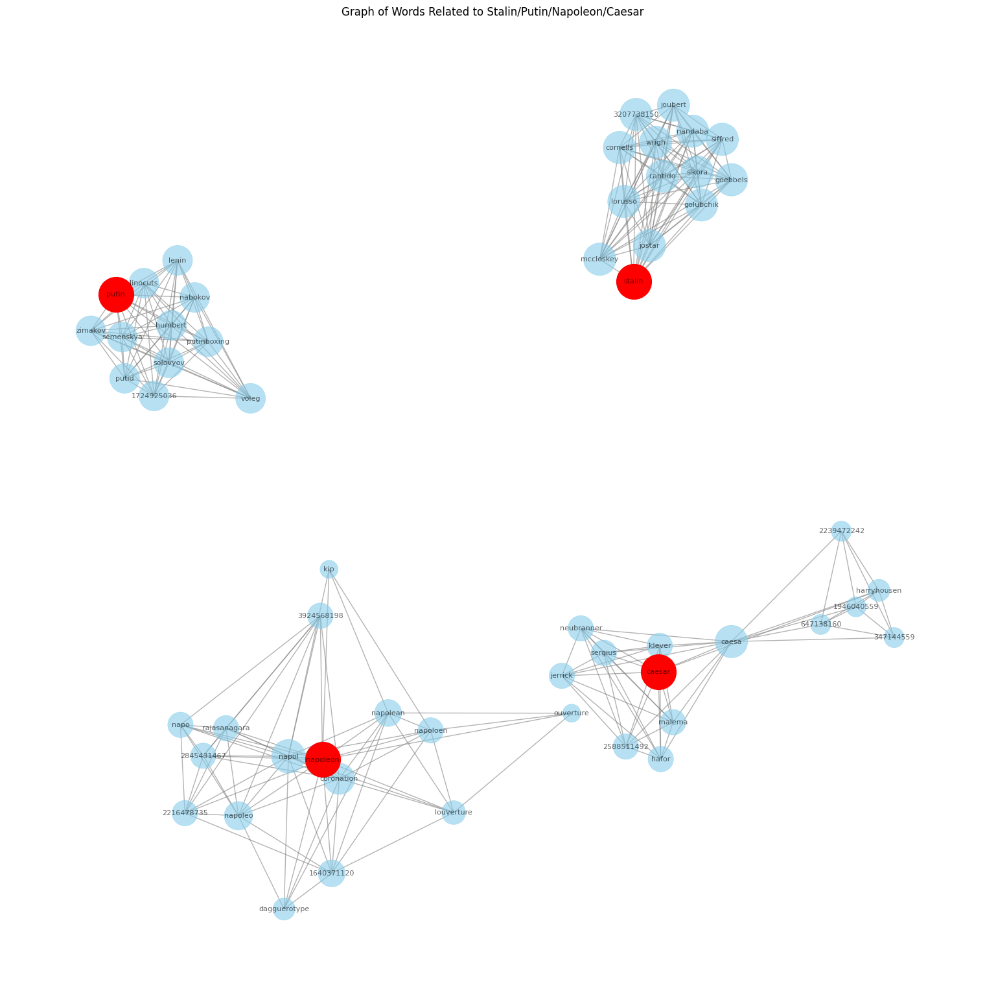

In [30]:
import matplotlib.pyplot as plt
import networkx as nx

# Define the seed words
seed_words = ['stalin', 'putin', 'napoleon', 'caesar']

# Create a graph
G = nx.Graph()

# Function to get related words
def get_related_words(word, model, depth=2):
    related = set([word])
    for _ in range(depth):
        new_words = set()
        for w in related:
            if w in model.wv:
                similar_words = model_w2v.wv.most_similar(w, topn=5)
                new_words.update([sw for sw, _ in similar_words])
        related.update(new_words)
    return related

# Get related words and add nodes and edges
all_related_words = set()
for seed in seed_words:
    related = get_related_words(seed, model_w2v)
    all_related_words.update(related)

G.add_nodes_from(all_related_words)

for word in all_related_words:
    if word in model_w2v.wv:
        similar_words = model_w2v.wv.most_similar(word, topn=40)
        for similar_word, similarity in similar_words:
            if similar_word in all_related_words:
                G.add_edge(word, similar_word, weight=similarity)

# Plot the graph
pos = nx.spring_layout(G, k=0.5, iterations=50)  # Adjust k for more spread out graph
plt.figure(figsize=(15, 15))

# Calculate node sizes based on degree
degrees = dict(G.degree())
node_sizes = [v * 100 for v in degrees.values()]  # Multiply by 100 to make sizes more visible

nx.draw(G, pos, with_labels=True, font_size=8,
        node_size=node_sizes,  # Use the calculated node sizes
        font_color='black', node_color='skyblue', edge_color='gray',
        linewidths=0.5, alpha=0.6)

# Add seed words with different color
nx.draw_networkx_nodes(G, pos, nodelist=seed_words, node_color='red', node_size=1500)

plt.title('Graph of Words Related to Stalin/Putin/Napoleon/Caesar')
plt.axis('off')
plt.tight_layout()
plt.show()

# Optionally, export the graph
nx.write_gexf(G, "grandshommesalacon_related_words_network.gexf")

## Let's try some viz

(ideas from Claude)

1. t-SNE or UMAP plot:

   - Reduce the high-dimensional word vectors to 2D or 3D using t-SNE or UMAP.
   - Plot the resulting points, with each point representing a word.
   - This allows you to see clusters of semantically related words.

2. Word similarity heatmap:

   - Choose a set of words and compute their pairwise cosine similarities.
   - Create a heatmap where color intensity represents similarity.


3. Word analogy visualization:

   - Illustrate word analogies (e.g., "king" - "man" + "woman" ≈ "queen").
   - Plot the vectors and their relationships in 2D or 3D space.


4. Principal Component Analysis (PCA):

   - Apply PCA to reduce dimensionality and visualize the first few principal components.
   - This can reveal the most important directions of variance in the embedding space.


5. Word clouds based on similarity:

   - For a given word, create a word cloud of its most similar words.
   - Size words based on their similarity scores.


6. Vector arithmetic visualization:

   - Show how vector addition and subtraction work in the embedding space.
   - Visualize examples like "France" + "capital" ≈ "Paris".


7. Semantic fields:

    - Choose a domain (e.g., "animals", "emotions") and visualize related words.
    - Use dimensionality reduction to plot these words in 2D or 3D.


8. Hierarchical clustering dendrogram:

   - Perform hierarchical clustering on a subset of words.
   - Visualize the resulting dendrogram to show word relationships.


9. Word trajectory analysis:

If you have embeddings from different time periods, visualize how word meanings change over time.


10. Bias visualization:

Explore and visualize potential biases in the embeddings (e.g., gender or racial biases).

In [18]:
import numpy as np
from sklearn.manifold import TSNE
import plotly.graph_objs as go
from plotly.offline import plot

# Assuming model_w2v is your Word2Vec model
model = model_w2v

# Seed words
seed_words = ["history", "historian", "historians", "historical", "past", "time"]

# Function to get similar words
def get_similar_words(model, word, n=100):
    try:
        similar_words = [word[0] for word in model.wv.most_similar(word, topn=n)]
        return similar_words
    except KeyError:
        return []  # Return empty list if word not in vocabulary

# Collect words
words = set(seed_words)
for seed in seed_words:
    words.update(get_similar_words(model, seed, n=200))  # Get 200 similar words for each seed
words = list(words)[:1000]  # Limit to 1000 words

# Get vectors
vectors = [model.wv[word] for word in words]

# Convert to numpy array
vectors = np.array(vectors)

# Apply t-SNE
tsne = TSNE(n_components=2, random_state=42)
vectors_tsne = tsne.fit_transform(vectors)

# Create a color map: seed words in red, others in blue
colors = ['red' if word in seed_words else 'blue' for word in words]

# Create text labels: only for seed words
text_labels = [word if word in seed_words else "" for word in words]

# Create the scatter plot
trace = go.Scatter(
    x=vectors_tsne[:, 0],
    y=vectors_tsne[:, 1],
    mode='markers+text',
    text=text_labels,
    hovertext=words,
    hoverinfo='text',
    marker=dict(
        size=5,
        color=colors,
        opacity=0.8
    ),
    textposition="top center",
    textfont=dict(size=9),
    showlegend=False
)

# Create the layout
layout = go.Layout(
    title="Interactive t-SNE visualization of word embeddings<br>Seed words: " + ", ".join(seed_words),
    hovermode='closest',
    xaxis=dict(title='t-SNE dimension 1', showticklabels=False),
    yaxis=dict(title='t-SNE dimension 2', showticklabels=False)
)

# Create the figure and plot
fig = go.Figure(data=[trace], layout=layout)
plot(fig, filename='word_embeddings_tsne.html')

'word_embeddings_tsne.html'

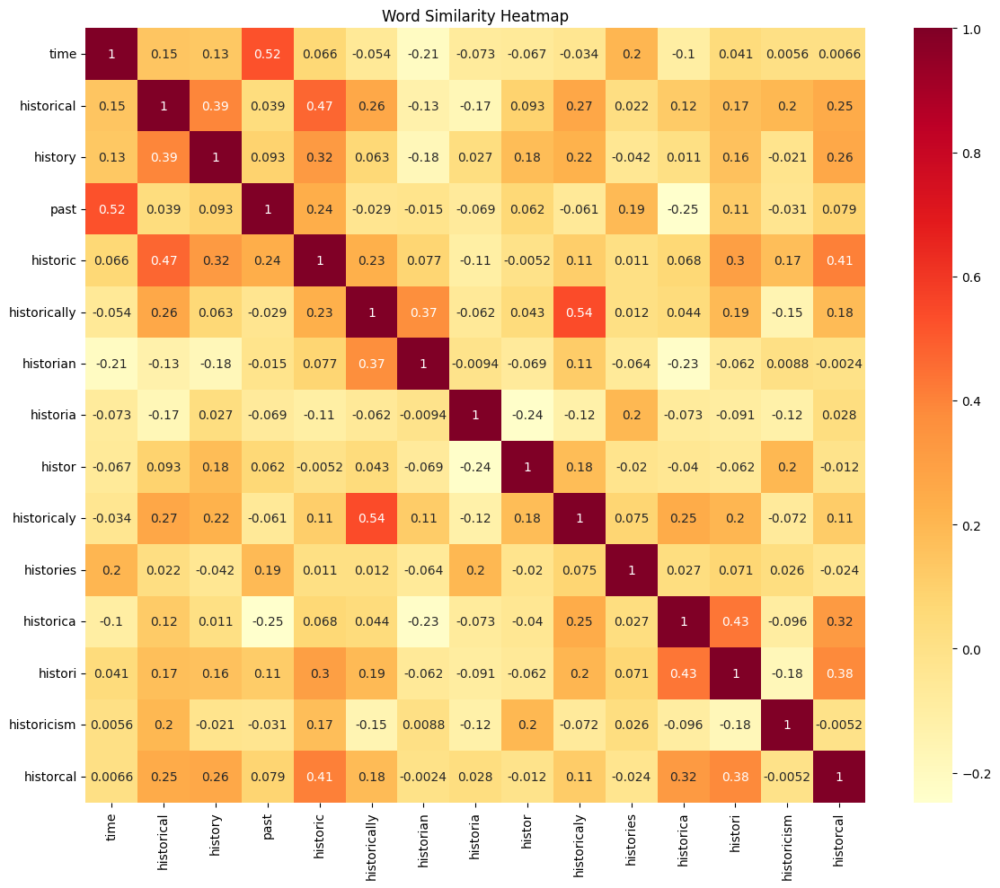

In [11]:
import numpy as np
import matplotlib.pyplot as plt
import seaborn as sns
from sklearn.metrics.pairwise import cosine_similarity

# Assuming model_w2v is your Word2Vec model
model = model_w2v

# Function to get words starting with a prefix
def get_words_with_prefix(model, prefix):
    return [word for word in model.wv.key_to_index.keys() if word.startswith(prefix)]

# Get words starting with 'histor'
histor_words = get_words_with_prefix(model, 'histor')

# Add 'time' and 'past' to the list
words = histor_words + ['time', 'past']

# Limit to top 15 most frequent words if the list is too long
if len(words) > 15:
    word_frequencies = [(word, model.wv.get_vecattr(word, "count")) for word in words]
    word_frequencies.sort(key=lambda x: x[1], reverse=True)
    words = [word for word, freq in word_frequencies[:15]]

# Compute word vectors
word_vectors = [model.wv[word] for word in words]

# Compute pairwise cosine similarities
similarity_matrix = cosine_similarity(word_vectors)

# Create heatmap
plt.figure(figsize=(12, 10))
sns.heatmap(similarity_matrix, annot=True, cmap='YlOrRd', xticklabels=words, yticklabels=words)
plt.title("Word Similarity Heatmap")
plt.tight_layout()
plt.show()

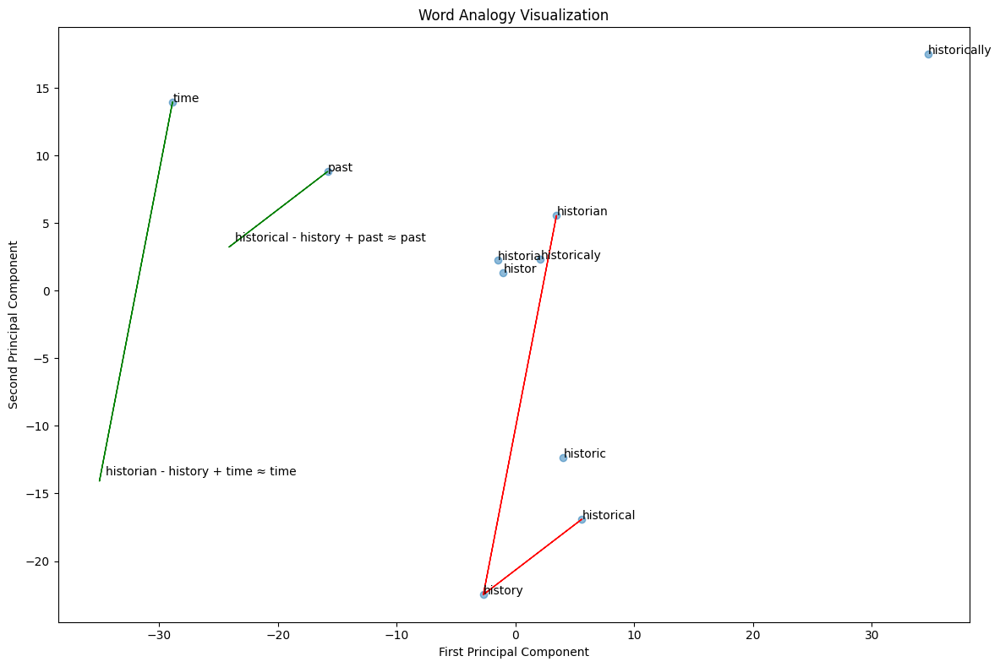

In [12]:
import numpy as np
import matplotlib.pyplot as plt
from sklearn.decomposition import PCA

# Assuming model_w2v is your Word2Vec model
model = model_w2v

# Function to get words starting with a prefix
def get_words_with_prefix(model, prefix):
    return [word for word in model.wv.key_to_index.keys() if word.startswith(prefix)]

# Get words starting with 'histor'
histor_words = get_words_with_prefix(model, 'histor')

# Add 'time' and 'past' to the list
words = histor_words + ['time', 'past']

# Limit to top 10 most frequent words if the list is too long
if len(words) > 10:
    word_frequencies = [(word, model.wv.get_vecattr(word, "count")) for word in words]
    word_frequencies.sort(key=lambda x: x[1], reverse=True)
    words = [word for word, freq in word_frequencies[:10]]

# Compute word vectors
word_vectors = [model.wv[word] for word in words]

# Perform PCA to reduce to 2D
pca = PCA(n_components=2)
word_vectors_2d = pca.fit_transform(word_vectors)

# Plot words
plt.figure(figsize=(12, 8))
plt.scatter(word_vectors_2d[:, 0], word_vectors_2d[:, 1], alpha=0.5)

# Annotate words
for i, word in enumerate(words):
    plt.annotate(word, (word_vectors_2d[i, 0], word_vectors_2d[i, 1]))

# Perform and plot analogies
def plot_analogy(w1, w2, w3):
    v1 = model.wv[w1]
    v2 = model.wv[w2]
    v3 = model.wv[w3]
    v_analogy = v3 - v1 + v2
    
    # Project the analogy vector to 2D
    v_analogy_2d = pca.transform([v_analogy])[0]
    
    # Plot the analogy
    plt.arrow(word_vectors_2d[words.index(w1), 0], word_vectors_2d[words.index(w1), 1],
              word_vectors_2d[words.index(w2), 0] - word_vectors_2d[words.index(w1), 0],
              word_vectors_2d[words.index(w2), 1] - word_vectors_2d[words.index(w1), 1],
              color='r', width=0.001, head_width=0.02)
    plt.arrow(word_vectors_2d[words.index(w3), 0], word_vectors_2d[words.index(w3), 1],
              v_analogy_2d[0] - word_vectors_2d[words.index(w3), 0],
              v_analogy_2d[1] - word_vectors_2d[words.index(w3), 1],
              color='g', width=0.001, head_width=0.02)
    
    # Find the closest word to the analogy
    closest_word = model.wv.most_similar([v_analogy], topn=1)[0][0]
    plt.annotate(f"{w1} - {w2} + {w3} ≈ {closest_word}", 
                 (v_analogy_2d[0], v_analogy_2d[1]), 
                 xytext=(5, 5), textcoords='offset points')

# Perform a few analogies
if 'historian' in words and 'history' in words and 'time' in words:
    plot_analogy('historian', 'history', 'time')
if 'historical' in words and 'history' in words and 'past' in words:
    plot_analogy('historical', 'history', 'past')

plt.title("Word Analogy Visualization")
plt.xlabel("First Principal Component")
plt.ylabel("Second Principal Component")
plt.tight_layout()
plt.show()

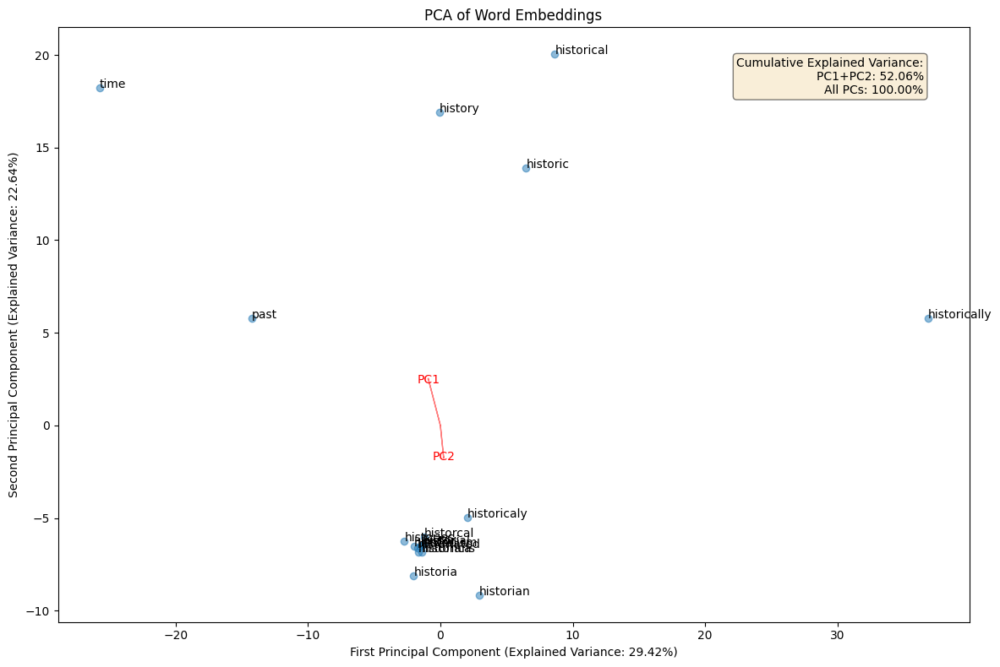

IndexError: list index out of range

In [15]:
import numpy as np
import matplotlib.pyplot as plt
from sklearn.decomposition import PCA

# Assuming model_w2v is your Word2Vec model
model = model_w2v

# Function to get words starting with a prefix
def get_words_with_prefix(model, prefix):
    return [word for word in model.wv.key_to_index.keys() if word.startswith(prefix)]

# Get words starting with 'histor'
histor_words = get_words_with_prefix(model, 'histor')

# Add 'time' and 'past' to the list
words = histor_words + ['time', 'past']

# Limit to top 20 most frequent words if the list is too long
if len(words) > 20:
    word_frequencies = [(word, model.wv.get_vecattr(word, "count")) for word in words]
    word_frequencies.sort(key=lambda x: x[1], reverse=True)
    words = [word for word, freq in word_frequencies[:20]]

# Compute word vectors
word_vectors = np.array([model.wv[word] for word in words])

# Apply PCA
pca = PCA()
word_vectors_pca = pca.fit_transform(word_vectors)

# Plot
plt.figure(figsize=(12, 8))

# Scatter plot of words in PC1 and PC2 space
plt.scatter(word_vectors_pca[:, 0], word_vectors_pca[:, 1], alpha=0.5)

# Annotate words
for i, word in enumerate(words):
    plt.annotate(word, (word_vectors_pca[i, 0], word_vectors_pca[i, 1]))

# Plot the principal component directions
scale = np.max(np.abs(word_vectors_pca[:, :2])) / 2
for i in range(2):
    plt.arrow(0, 0, scale * pca.components_[i, 0], scale * pca.components_[i, 1],
              color='r', alpha=0.5, head_width=0.05, head_length=0.1)
    plt.text(scale * pca.components_[i, 0], scale * pca.components_[i, 1], f'PC{i+1}',
             color='r', ha='center', va='center')

plt.title("PCA of Word Embeddings")
plt.xlabel(f"First Principal Component (Explained Variance: {pca.explained_variance_ratio_[0]:.2%})")
plt.ylabel(f"Second Principal Component (Explained Variance: {pca.explained_variance_ratio_[1]:.2%})")

# Add a text box with cumulative explained variance
cumulative_variance = np.cumsum(pca.explained_variance_ratio_)
plt.text(0.95, 0.95, f"Cumulative Explained Variance:\nPC1+PC2: {cumulative_variance[1]:.2%}\nAll PCs: {cumulative_variance[-1]:.2%}",
         transform=plt.gca().transAxes, verticalalignment='top', horizontalalignment='right',
         bbox=dict(boxstyle='round', facecolor='wheat', alpha=0.5))

plt.tight_layout()
plt.show()

# Print top words contributing to each principal component
def print_top_words_per_pc(pca, words, n_components=2, n_top_words=5):
    for i in range(min(n_components, len(words))):
        sorted_indices = np.argsort(np.abs(pca.components_[i]))[::-1]
        top_words = [words[idx] for idx in sorted_indices[:min(n_top_words, len(words))]]
        print(f"Top words for PC{i+1}: {', '.join(top_words)}")

print_top_words_per_pc(pca, words)



   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 173.2/173.2 kB 3.6 MB/s eta 0:00:00a 0:00:01


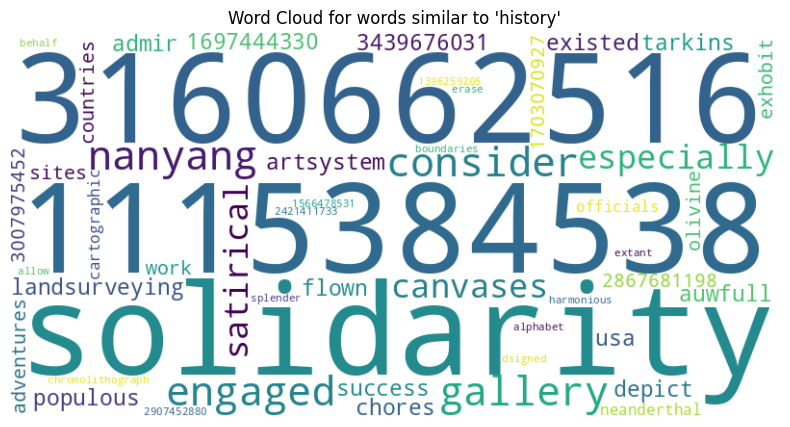

Top 10 words most similar to 'history':
solidarity: 0.5168
3160662516: 0.5093
1115384538: 0.5093
gallery: 0.5031
nanyang: 0.4974
engaged: 0.4921
consider: 0.4907
especially: 0.4904
canvases: 0.4858
satirical: 0.4807


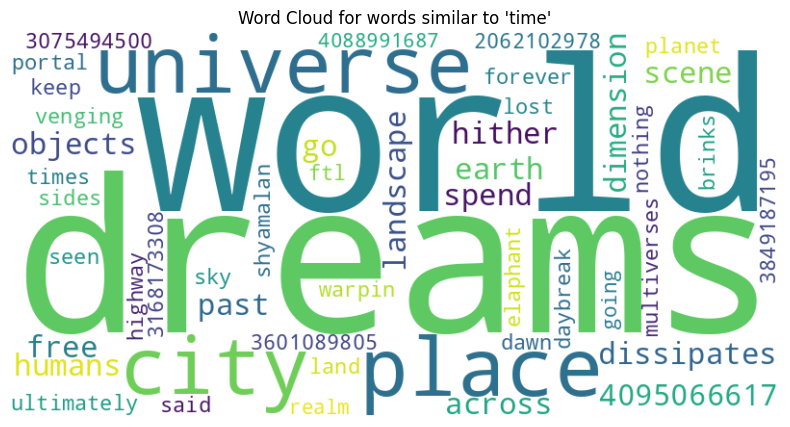

Top 10 words most similar to 'time':
dreams: 0.5831
world: 0.5823
place: 0.5612
universe: 0.5469
city: 0.5464
4095066617: 0.5333
scene: 0.5296
past: 0.5248
dissipates: 0.5126
earth: 0.5118


In [17]:
!pip install wordcloud
import matplotlib.pyplot as plt
from wordcloud import WordCloud
import numpy as np

# Assuming model_w2v is your Word2Vec model
model = model_w2v

def create_similarity_wordcloud(model, word, n=50):
    # Get similar words
    similar_words = model.wv.most_similar(word, topn=n)
    
    # Create a dictionary of words and their similarity scores
    word_score_dict = {word: score for word, score in similar_words}
    
    # Create and generate a word cloud image
    wordcloud = WordCloud(width=800, height=400, background_color='white', 
                          min_font_size=10).generate_from_frequencies(word_score_dict)
    
    # Display the generated image
    plt.figure(figsize=(10, 5))
    plt.imshow(wordcloud, interpolation='bilinear')
    plt.axis("off")
    plt.title(f"Word Cloud for words similar to '{word}'")
    plt.show()
    
    # Print top 10 similar words with their scores
    print(f"Top 10 words most similar to '{word}':")
    for similar_word, score in similar_words[:10]:
        print(f"{similar_word}: {score:.4f}")

# Create word clouds for 'history' and 'time'
create_similarity_wordcloud(model, 'history')
create_similarity_wordcloud(model, 'time')

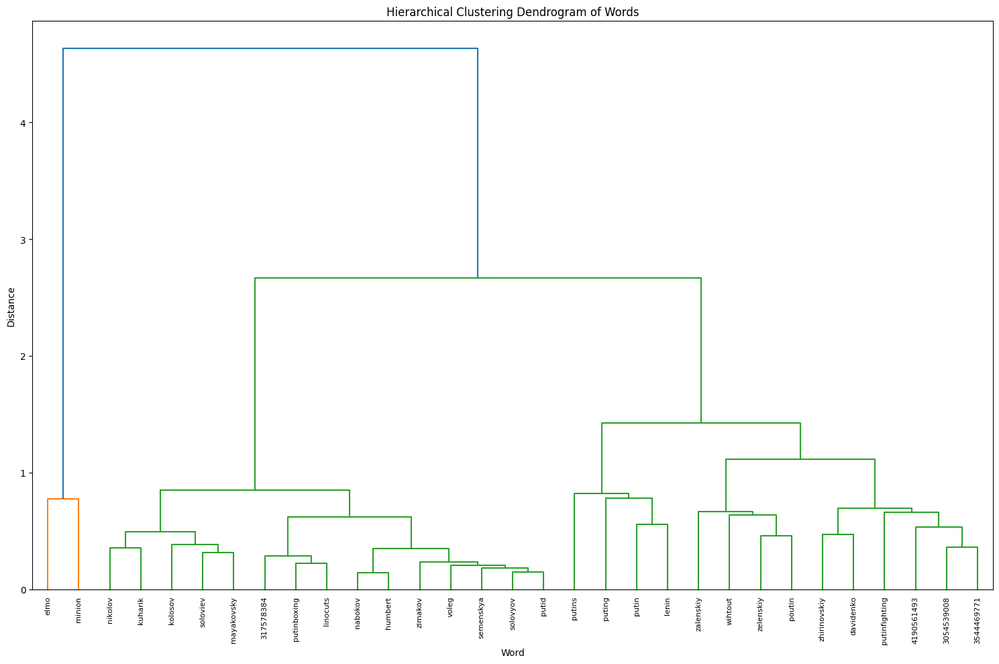

In [21]:
import numpy as np
import matplotlib.pyplot as plt
from scipy.cluster.hierarchy import dendrogram, linkage
from sklearn.metrics.pairwise import cosine_similarity

# Assuming model_w2v is your Word2Vec model
model = model_w2v

def get_related_words(model, seed_word, n=30):
    """Get words related to the seed word"""
    related = model.wv.most_similar(seed_word, topn=n)
    words = [seed_word] + [word for word, _ in related]
    return words

def create_hierarchical_clustering_dendrogram(model, words):
    # Get word vectors
    vectors = np.array([model.wv[word] for word in words])
    
    # Compute cosine similarity
    similarity_matrix = cosine_similarity(vectors)
    
    # Convert similarity to distance
    distance_matrix = 1 - similarity_matrix
    
    # Perform hierarchical clustering
    linkage_matrix = linkage(distance_matrix, method='ward')
    
    # Create dendrogram
    plt.figure(figsize=(15, 10))
    dendrogram(linkage_matrix, labels=words, leaf_rotation=90, leaf_font_size=8)
    plt.title("Hierarchical Clustering Dendrogram of Words")
    plt.xlabel("Word")
    plt.ylabel("Distance")
    plt.tight_layout()
    plt.show()

# Get words related to 'history'
history_words = get_related_words(model, 'putin', n=30)

# Create and display the dendrogram
create_hierarchical_clustering_dendrogram(model, history_words)